In [2]:
import pandas as pd
import numpy as np

train_df = pd.read_csv('train.csv')
test_df = pd.read_csv('test.csv')
train_df.columns = train_df.columns.str.replace('rainfall_train.', '', regex=False)
test_df.columns = test_df.columns.str.replace('rainfall_test.', '', regex=False)

#columns = ['dh', 'v01', 'v02', 'v03','v04', 'v05', 'v06', 'v07', 'v08', 'v09', 'vv', 'class_interval'] # with numerical data
columns = ['stn4contest','dh', 'ef_year', 'ef_month', 'ef_day', 'ef_hour', 'v01', 'v02', 'v03','v04', 'v05', 'v06', 'v07', 'v08', 'v09', 'vv', 'class_interval']
train_df = train_df[columns]
train_df = train_df[train_df['vv']>=0]

class0 = train_df[train_df['class_interval']==0]
class1 = train_df[train_df['class_interval']==1]
class2 = train_df[train_df['class_interval']==2]
class3 = train_df[train_df['class_interval']==3]
class4 = train_df[train_df['class_interval']==4]
class5 = train_df[train_df['class_interval']==5]
class6 = train_df[train_df['class_interval']==6]
class7 = train_df[train_df['class_interval']==7]
class8 = train_df[train_df['class_interval']==8]
class9 = train_df[train_df['class_interval']==9]

In [10]:
filtered_class0 = class0[
    (class0['v01'] <= 40) &
    (class0['v02'] <= 31) &
    (class0['v03'] <= 20) &
    (class0['v04'] <= 13) &
    (class0['v05'] <= 8) &
    (class0['v06'] <= 3) &
    (class0['v07'] == 0) &
    (class0['v08'] == 0) &
    (class0['v09'] == 0)
]
filtered_class1 = class1[class1['v01']>0]
filtered_class2 = class2[class2['v01']>0]
filtered_class3 = class3[class3['v01']>0]
filtered_class4 = class4[class4['v01']>0]
filtered_class5 = class5[class5['v01']>0]
filtered_class6 = class6[class6['v01']>0]
filtered_class7 = class7[class7['v01']>0]
filtered_class8 = class8[class8['v01']>0]
filtered_class9 = class9[class9['v01']>0]

dataframes = [filtered_class0,filtered_class1,filtered_class2,filtered_class3,filtered_class4,filtered_class5,filtered_class6,filtered_class7,filtered_class8,filtered_class9]
filtered_df = pd.concat(dataframes,axis=0)

In [6]:
from sklearn.preprocessing import LabelEncoder
le = LabelEncoder()
filtered_df['class_interval'] = le.fit_transform(filtered_df['class_interval'])
filtered_df['ef_year'] = le.fit_transform(filtered_df['ef_year'])
filtered_df['ef_month'] = le.fit_transform(filtered_df['ef_month'])
filtered_df['ef_day'] = le.fit_transform(filtered_df['ef_day'])
filtered_df['stn4contest'] = le.fit_transform(filtered_df['stn4contest'])

In [9]:
from sklearn.model_selection import train_test_split
X = filtered_df.drop(['vv','class_interval','ef_year','ef_hour'],axis=1)
y = filtered_df['class_interval']
X_train, X_test, y_train, y_test = train_test_split(X,y,test_size=0.2,random_state=42)

In [10]:
from imblearn.over_sampling import SMOTE
smote = SMOTE(random_state=42)
X_resampled, y_resampled = smote.fit_resample(X_train, y_train)

In [11]:
from sklearn.metrics import confusion_matrix, recall_score, accuracy_score, precision_score, f1_score
from xgboost import XGBClassifier
XGboost = XGBClassifier(random_state=42)
XGboost.fit(X_resampled,y_resampled)

XGBClassifier(base_score=None, booster=None, callbacks=None,
              colsample_bylevel=None, colsample_bynode=None,
              colsample_bytree=None, device=None, early_stopping_rounds=None,
              enable_categorical=False, eval_metric=None, feature_types=None,
              gamma=None, grow_policy=None, importance_type=None,
              interaction_constraints=None, learning_rate=None, max_bin=None,
              max_cat_threshold=None, max_cat_to_onehot=None,
              max_delta_step=None, max_depth=None, max_leaves=None,
              min_child_weight=None, missing=nan, monotone_constraints=None,
              multi_strategy=None, n_estimators=None, n_jobs=None,
              num_parallel_tree=None, objective='multi:softprob', ...)

<Axes: >

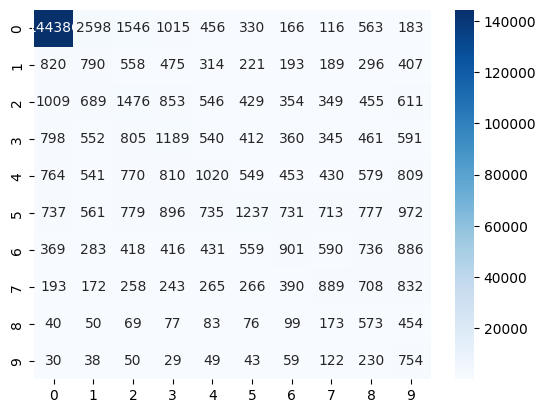

In [12]:
from sklearn.metrics import confusion_matrix
import seaborn as sns
y_pred = XGboost.predict(X_test)
cm = confusion_matrix(y_test, y_pred)
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues')

In [58]:
def clf_eval(y_pred,y_test):
    cm = confusion_matrix(y_test, y_pred)
    C11 = cm[0][0]
    M = cm[1:,0].sum()
    H = sum([cm[i][i] for i in range(1,10)])
    F = sum(sum(cm)) - H - M - C11
    clf = H / (H + F + M)
    return clf

In [47]:
filtered_dfs = {}
# Loop through the multiples of 3 from 3 to 80
for dh_value in range(3, 243, 3):
    filtered_dfs[dh_value] = filtered_df[filtered_df['dh'] == dh_value]

In [50]:
resampled_3 = filtered_dfs[3]
smote = SMOTE(random_state=42)
X_resampled, y_resampled = smote.fit_resample(X_train, y_train)

,stn4contest,dh,ef_year,ef_month,ef_day,ef_hour,v01,v02,v03,v04,v05,v06,v07,v08,v09,vv,class_interval
0,0,3,0,0,0,12,0,0,0,0,0,0,0,0,0,0.0,0
80,0,3,0,0,1,0,0,0,0,0,0,0,0,0,0,0.0,0
160,0,3,0,0,1,12,12,2,0,0,0,0,0,0,0,0.0,0
240,0,3,0,0,2,0,2,0,0,0,0,0,0,0,0,0.0,0
320,0,3,0,0,2,12,34,28,16,7,3,0,0,0,0,0.0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1303896,13,3,2,3,19,12,100,100,100,100,96,72,46,8,0,30.6,9
1330101,14,3,2,3,30,12,100,100,100,100,100,95,41,3,0,32.9,9
1370831,16,3,2,2,10,12,100,100,96,76,62,25,3,2,0,35.9,9
1371951,16,3,2,2,17,12,100,100,100,100,100,90,45,4,0,34.4,9


In [100]:
def preprocess(filtered_df):
    filtered_df = filtered_df.copy()
    le = LabelEncoder()
    filtered_df['class_interval'] = le.fit_transform(filtered_df['class_interval'])
    filtered_df['ef_year'] = le.fit_transform(filtered_df['ef_year'])
    filtered_df['ef_month'] = le.fit_transform(filtered_df['ef_month'])
    filtered_df['ef_day'] = le.fit_transform(filtered_df['ef_day'])
    filtered_df['stn4contest'] = le.fit_transform(filtered_df['stn4contest'])
    X = filtered_df.drop(['vv','class_interval','ef_year','ef_hour'],axis=1)
    y = filtered_df['class_interval']
    X_train, X_test, y_train, y_test = train_test_split(X,y,test_size=0.2,random_state=42)
    return X_train,X_test,y_train,y_test

In [99]:
def resample(X,y):
    smote = SMOTE(random_state=42)
    X_resampled, y_resampled = smote.fit_resample(X_train, y_train)
    return X_resampled, y_resampled

In [102]:
# def train(X_train,y_train,X_test):
#     XGboost = XGBClassifier(random_state=42)
#     XGboost.fit(X_train,y_train)
#     y_pred = XGboost.predict(X_test)
#     return y_pred 

def train(X_train,y_train):
    XGboost = XGBClassifier(random_state=42)
    XGboost.fit(X_train,y_train)
    return XGboost

In [ ]:
clf_eval(y_pred,y_test)

In [97]:
X_train,X_test,y_train,y_test = preprocess(filtered_dfs[3])
X_resampled,y_resampled = resample(X_train,y_train)
y_pred = train(X_resampled,y_resampled,X_test)
score = clf_eval(y_pred,y_test)
print(score)

0.20426287744227353


In [113]:
from sklearn.ensemble import VotingClassifier
from sklearn.base import clone

classifiers = []

for i in range(3, 243,3):
    X_train, X_test, y_train, y_test = preprocess(filtered_dfs[i])
    X_resampled, y_resampled = resample(X_train, y_train)
    
    # Assuming train function returns a trained classifier, we modify it to return the trained model
    clf = train(X_resampled, y_resampled)
    
    # Append the trained classifier to the list
    classifiers.append((f'model_{i}', clone(clf)))

# Create a VotingClassifier
voting_clf = VotingClassifier(estimators=classifiers, voting='soft')

# Fit the voting classifier on the entire training data
# Here, we'll use the data from the last processed dataframe for fitting
X_train, X_test, y_train, y_test = preprocess(filtered_df)
voting_clf.fit(X_train, y_train)

# Make predictions using the voting classifier
y_pred_ensemble = voting_clf.predict(X_test)

# Evaluate the ensemble predictions
score = clf_eval(y_pred_ensemble, y_test)
print(score)

0.2662192892495653


In [135]:
# filter 안된 train을 앙상블 모데링 학습했을 때 
le = LabelEncoder()

X = train_df.drop(['vv','class_interval','ef_year','ef_day','ef_hour'],axis=1)
y = train_df['class_interval']

X['ef_month'] = le.fit_transform(X['ef_month'])
X['stn4contest'] = le.fit_transform(X['stn4contest'])

X_train, X_test, y_train, y_test = train_test_split(X,y,test_size=0.2,random_state=42)
voting_clf.fit(X_train,y_train)
y_pred = voting_clf.predict(X_test)
score = clf_eval(y_pred,y_test)
print(score)

0.03130075947144299


In [130]:
def test_ensemble(train_df,ensemble_model):
    le = LabelEncoder()
    X = train_df.drop(['vv','class_interval','ef_year','ef_day','ef_hour'],axis=1)
    y = train_df['class_interval']
    X['ef_month'] = le.fit_transform(X['ef_month'])
    X['stn4contest'] = le.fit_transform(X['stn4contest'])
    X_train, X_test, y_train, y_test = train_test_split(X,y,test_size=0.2,random_state=42)
    ensemble_model.fit(X_train,y_train)
    y_pred = ensemble_model.predict(X_test)
    score = clf_eval(y_pred,y_test)
    return score

1159009

In [227]:
'''
train_csv => train_df  => 
(train_df) : 이상치 제거 => 
preprocess(filtered_df) : train test로 나눔 => resample(X_train) : SMOTE => train : XGboost 학습

'''

def filtering(train_df):
    try:
        train_df.columns = train_df.columns.str.replace('rainfall_train.', '', regex=False)
        test_df.columns = test_df.columns.str.replace('rainfall_test.', '', regex=False)

        #columns = ['dh', 'v01', 'v02', 'v03','v04', 'v05', 'v06', 'v07', 'v08', 'v09', 'vv', 'class_interval'] # with numerical data
        columns = ['stn4contest','dh', 'ef_year', 'ef_month', 'ef_day', 'ef_hour', 'v01', 'v02', 'v03','v04', 'v05', 'v06', 'v07', 'v08', 'v09', 'vv', 'class_interval']
        train_df = train_df[columns]
        train_df = train_df[train_df['vv']>=0]
    except:
        class0 = train_df[train_df['class_interval']==0]
        class1 = train_df[train_df['class_interval']==1]
        class2 = train_df[train_df['class_interval']==2]
        class3 = train_df[train_df['class_interval']==3]
        class4 = train_df[train_df['class_interval']==4]
        class5 = train_df[train_df['class_interval']==5]
        class6 = train_df[train_df['class_interval']==6]
        class7 = train_df[train_df['class_interval']==7]
        class8 = train_df[train_df['class_interval']==8]
        class9 = train_df[train_df['class_interval']==9]
        filtered_class0 = class0[
        (class0['v01'] <= 40) &
        (class0['v02'] <= 31) &
        (class0['v03'] <= 20) &
        (class0['v04'] <= 13) &
        (class0['v05'] <= 8) &
        (class0['v06'] <= 3) &
        (class0['v07'] == 0) &
        (class0['v08'] == 0) &
        (class0['v09'] == 0)
    ]
        filtered_class1 = class1[class1['v01']>0]
        filtered_class2 = class2[class2['v01']>0]
        filtered_class3 = class3[class3['v01']>0]
        filtered_class4 = class4[class4['v01']>0]
        filtered_class5 = class5[class5['v01']>0]
        filtered_class6 = class6[class6['v01']>0]
        filtered_class7 = class7[class7['v01']>0]
        filtered_class8 = class8[class8['v01']>0]
        filtered_class9 = class9[class9['v01']>0]

        dataframes = [filtered_class0,filtered_class1,filtered_class2,filtered_class3,filtered_class4,filtered_class5,filtered_class6,filtered_class7,filtered_class8,filtered_class9]
        filtered_dataframe = pd.concat(dataframes,axis=0)
    return filtered_dataframe

In [198]:
filtered_dfs = {}
# Loop through the multiples of 3 from 3 to 80
for stn_value in range(20):
    filtered_dfs[stn_value] = filtered_df[filtered_df['stn4contest'] == stn_value]


classifiers = []

for i in range(20):
    X_train, X_test, y_train, y_test = preprocess(filtered_dfs[i])
    X_resampled, y_resampled = resample(X_train, y_train)
    
    # Assuming train function returns a trained classifier, we modify it to return the trained model
    clf = train(X_resampled, y_resampled)
    
    # Append the trained classifier to the list
    classifiers.append((f'model_{i}', clone(clf)))

# Create a VotingClassifier
voting_clf = VotingClassifier(estimators=classifiers, voting='soft')

# 4분 걸림림

In [199]:
from imblearn.over_sampling import SMOTE
'''
train_df (결측치 없는 data)에서 필요 column만 남김
train_df에서 train,test로 나눈다
train에 대해서만 filtering을 한다
filtering된 train을 앙상블 모델에 학습시킨다
앙상블 모델을 filtering되지 않은 test에 predict하여 score를 본다 : 0.03 처참하다
'''

X = train_df.drop(['vv','class_interval','ef_year','ef_day','ef_hour'],axis=1)
y = train_df['class_interval']
X_train,X_test,y_train,y_test = train_test_split(X,y,random_state=42)

train_before_filter = pd.concat([X_train,y_train],axis=1)
train_after_filter = filtering(train_before_filter)

le = LabelEncoder()
train_after_filter['stn4contest'] = le.fit_transform(train_after_filter['stn4contest'])
train_after_filter['ef_month'] = le.fit_transform(train_after_filter['ef_month'])


X_train_filterd = train_after_filter.drop('class_interval',axis=1)
y_train_filterd = train_after_filter['class_interval']


smote = SMOTE(random_state=42)
X_resampled, y_resampled = smote.fit_resample(X_train_filterd, y_train_filterd)
    
voting_clf.fit(X_train_filterd,y_train_filterd)

VotingClassifier(estimators=[('model_0',
                              XGBClassifier(base_score=None, booster=None,
                                            callbacks=None,
                                            colsample_bylevel=None,
                                            colsample_bynode=None,
                                            colsample_bytree=None, device=None,
                                            early_stopping_rounds=None,
                                            enable_categorical=False,
                                            eval_metric=None,
                                            feature_types=None, gamma=None,
                                            grow_policy=None,
                                            importance_type=None,
                                            interaction_constraints=None,
                                            learnin...
                                            importance_type=None,
                                            interaction_constraints=None,
                                            learning_rate=None, max_bin=None,
                                            max_cat_threshold=None,
                                            max_cat_to_onehot=None,
                                            max_delta_step=None, max_depth=None,
                                            max_leaves=None,
                                            min_child_weight=None, missing=nan,
                                            monotone_constraints=None,
                                            multi_strategy=None,
                                            n_estimators=None, n_jobs=None,
                                            num_parallel_tree=None,
                                            objective='multi:softprob', ...))],
                 voting='soft')

In [200]:
X_test['stn4contest'] = le.fit_transform(X_test['stn4contest'])
X_test['ef_month'] = le.fit_transform(X_test['ef_month'])
y_pred = voting_clf.predict(X_test)
score = clf_eval(y_pred,y_test)

In [201]:
print(score)

0.06260394530167236


In [ ]:
filtered_df['class_interval'] = le.fit_transform(filtered_df['class_interval'])
filtered_df['ef_year'] = le.fit_transform(filtered_df['ef_year'])
filtered_df['ef_month'] = le.fit_transform(filtered_df['ef_month'])
filtered_df['ef_day'] = le.fit_transform(filtered_df['ef_day'])
filtered_df['stn4contest'] = le.fit_transform(filtered_df['stn4contest'])

In [174]:
X_train

,stn4contest,dh,ef_month,v01,v02,v03,v04,v05,v06,v07,v08,v09
867153,STN018,198,9,19,14,8,6,5,3,0,0,0
806890,STN017,117,6,3,1,1,0,0,0,0,0,0
1293702,STN014,141,6,13,6,2,2,1,0,0,0,0
852122,STN018,225,6,6,4,2,2,2,2,2,0,0
656157,STN014,36,5,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...
260343,STN006,24,8,2,2,0,0,0,0,0,0,0
1422653,STN019,159,8,65,55,20,6,4,0,0,0,0
132442,STN003,165,7,24,14,9,5,1,0,0,0,0
674081,STN014,48,9,69,43,22,11,5,0,0,0,0


Binomial ensemble

<Axes: >

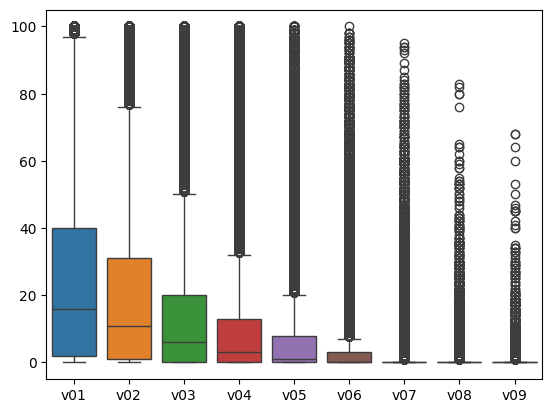

In [57]:
import seaborn as sns
import matplotlib.pyplot as plt
plot_figure = ['v01','v02','v03','v04','v05','v06','v07','v08','v09']
sns.boxplot(class0[plot_figure])

In [48]:
class1.describe()

,dh,ef_month,ef_day,ef_hour,v01,v02,v03,v04,v05,v06,v07,v08,v09,vv,class_interval
count,21562.000000,21562.000000,21562.000000,21562.000000,21562.000000,21562.000000,21562.000000,21562.000000,21562.000000,21562.000000,21562.000000,21562.000000,21562.000000,2.156200e+04,21562.0
mean,122.032465,7.221779,15.671923,9.450793,51.299323,44.316251,33.377238,24.558343,16.585103,7.799648,3.096188,0.662833,0.199518,1.000000e-01,1.0
std,69.397967,1.322239,9.073430,6.613518,28.515805,27.733735,25.253459,22.119214,18.108307,11.489130,6.105721,2.005336,0.895383,1.387811e-17,0.0
min,3.000000,5.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000e-01,1.0
25%,63.000000,6.000000,8.000000,3.000000,27.000000,21.000000,13.000000,7.000000,3.000000,0.000000,0.000000,0.000000,0.000000,1.000000e-01,1.0
50%,123.000000,7.000000,15.000000,9.000000,51.000000,42.000000,28.000000,18.000000,10.000000,3.000000,0.000000,0.000000,0.000000,1.000000e-01,1.0
75%,183.000000,8.000000,24.000000,15.000000,75.000000,66.000000,50.000000,37.000000,24.000000,11.000000,4.000000,0.000000,0.000000,1.000000e-01,1.0
max,240.000000,10.000000,31.000000,21.000000,100.000000,100.000000,100.000000,100.000000,100.000000,99.000000,84.000000,38.000000,25.000000,1.000000e-01,1.0


In [35]:
filtered_class1

,stn4contest,dh,ef_year,ef_month,ef_day,ef_hour,v01,v02,v03,v04,v05,v06,v07,v08,v09,vv,class_interval
70,STN001,213,A,5,10,6,34,32,26,19,15,7,4,0,0,0.1,1
71,STN001,216,A,5,10,9,34,32,26,19,15,7,4,0,0,0.1,1
146,STN001,201,A,5,10,6,24,24,20,14,8,6,3,0,0,0.1,1
147,STN001,204,A,5,10,9,24,24,20,14,8,6,3,0,0,0.1,1
222,STN001,189,A,5,10,6,28,26,19,17,6,2,2,0,0,0.1,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1453944,STN020,57,C,9,12,18,80,75,64,47,24,6,2,0,0,0.1,1
1454020,STN020,45,C,9,12,18,79,73,66,52,30,9,5,1,0,0.1,1
1454096,STN020,33,C,9,12,18,83,75,64,49,16,3,0,0,0,0.1,1
1454172,STN020,21,C,9,12,18,84,75,65,50,18,0,0,0,0,0.1,1


In [142]:
import pandas as pd
import numpy as np
from sklearn.preprocessing import LabelEncoder
from sklearn.preprocessing import MinMaxScaler,StandardScaler,RobustScaler

le = LabelEncoder()


data_df = pd.read_csv('sequential.csv')
columns_drop = ['label','vv','Unnamed: 0']
data_df = data_df.drop(columns = columns_drop)

le_stn4contest = LabelEncoder()
le_ef_month = LabelEncoder()
le_class_interval = LabelEncoder()
le_ef_year = LabelEncoder()

# Encode categorical columns
data_df['stn4contest'] = le_stn4contest.fit_transform(data_df['stn4contest'])
data_df['ef_month'] = le_ef_month.fit_transform(data_df['ef_month'])
data_df['ef_year'] = le_ef_month.fit_transform(data_df['ef_year'])
data_df['class_interval'] = le_class_interval.fit_transform(data_df['class_interval'])

scaler_std = RobustScaler()
std_scale_column = ['v01','v02','v03','v04','v05','v06','v07','v08','v09'] # dh는 scale하지 말자 => 정보 손실
data_df['dh']= data_df['dh']/ 240
grouped_counts = data_df.groupby(['stn4contest','ef_year', 'ef_month', 'ef_day', 'ef_hour']).size()

# Reset index to turn the Series into a DataFrame (if desired)
grouped_counts = grouped_counts.reset_index(name='count')

# Display the result
print(grouped_counts['count'])

start_idx = 0
xs = []
ys = []
meta_data = []

start_idx = 0
for index, row in grouped_counts.iterrows():
    seq_length = row['count']
    end_idx = start_idx + seq_length
    if end_idx <= len(data_df):
        x = data_df.iloc[int(start_idx):int(end_idx)].drop(columns=['class_interval', 'ef_year','ef_hour','ef_day'], axis=1).values
        y = data_df.iloc[int(end_idx) - 1]['class_interval']
        xs.append(x)
        ys.append(y)
        meta_data.append([row['stn4contest'], row['ef_year'], row['ef_month'], row['ef_day'], row['ef_hour']])
    start_idx = end_idx

0        1
1        1
2        1
3        1
4        2
        ..
77518    2
77519    1
77520    1
77521    1
77522    1
Name: count, Length: 77523, dtype: int64


In [143]:
from tensorflow.keras.preprocessing.sequence import pad_sequences

def zero_padding(xs):
    # Find the length of the longest sequence
    max_seq_length = max(len(seq) for seq in xs)
    # Pad sequences with zeros to make them all the same length
    padded_sequences = pad_sequences(xs, maxlen=max_seq_length, dtype='float32', padding='post')
    return padded_sequences

xs = np.array(zero_padding(xs))
ys = np.array(ys)

Epoch 1/50
1551/1551 [==============================] - 38s 22ms/step - loss: 0.7502 - accuracy: 0.8058 - val_loss: 0.5372 - val_accuracy: 0.8472
Epoch 2/50
1551/1551 [==============================] - 34s 22ms/step - loss: 0.5335 - accuracy: 0.8502 - val_loss: 0.5101 - val_accuracy: 0.8474
Epoch 3/50
1551/1551 [==============================] - 33s 21ms/step - loss: 0.5185 - accuracy: 0.8522 - val_loss: 0.5123 - val_accuracy: 0.8515
Epoch 4/50
1551/1551 [==============================] - 32s 21ms/step - loss: 0.5099 - accuracy: 0.8540 - val_loss: 0.4963 - val_accuracy: 0.8525
Epoch 5/50
1551/1551 [==============================] - 32s 20ms/step - loss: 0.5062 - accuracy: 0.8539 - val_loss: 0.4971 - val_accuracy: 0.8531
Epoch 6/50
1551/1551 [==============================] - 32s 21ms/step - loss: 0.5037 - accuracy: 0.8543 - val_loss: 0.5086 - val_accuracy: 0.8498
Epoch 7/50
1551/1551 [==============================] - 32s 21ms/step - loss: 0.5014 - accuracy: 0.8549 - val_loss: 0.4951 -

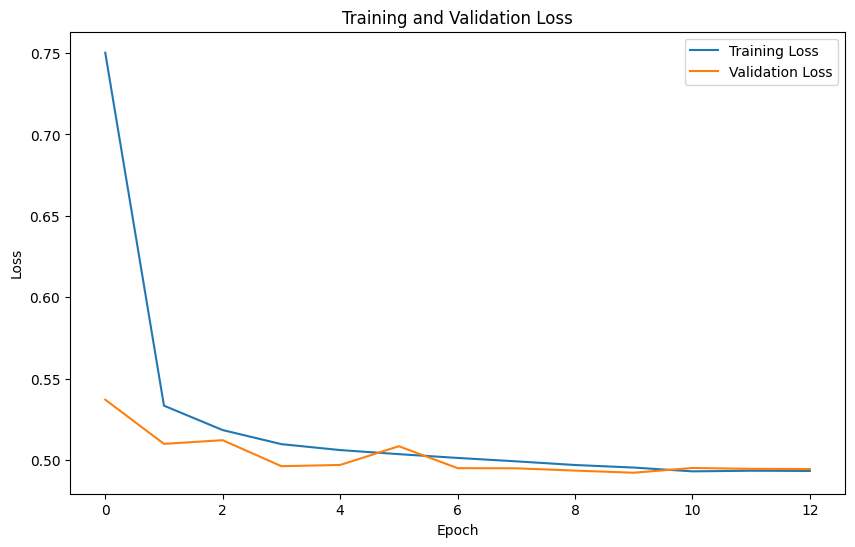

485/485 [==============================] - 4s 7ms/step


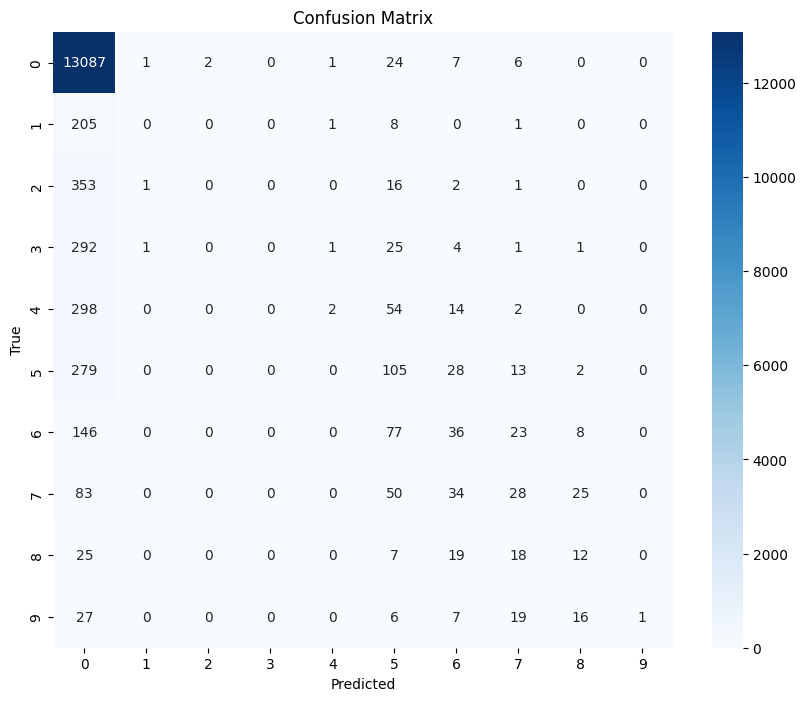

Accuracy: 0.8559174459851661
F1 Score: 0.8075922798676007


In [144]:
import numpy as np
from sklearn.preprocessing import LabelEncoder, StandardScaler
from sklearn.model_selection import train_test_split
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import LSTM, Dense, BatchNormalization, Dropout,SimpleRNN
from tensorflow.keras.utils import to_categorical
from tensorflow.keras.callbacks import EarlyStopping
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics import confusion_matrix, accuracy_score, f1_score

xs_flattened = [item.flatten() for item in xs]
xs_reshaped = np.array(xs_flattened).reshape(len(xs_flattened), -1, len(xs[0][0]))
ys_encoded = LabelEncoder().fit_transform(ys)
ys_categorical = to_categorical(ys_encoded)
x_train, x_test, y_train, y_test = train_test_split(xs_reshaped, ys_categorical, test_size=0.2, random_state=42)

model = Sequential()
model.add(LSTM(50, activation='relu', input_shape=(x_train.shape[1], x_train.shape[2]), return_sequences=True))
model.add(BatchNormalization())
model.add(Dropout(0.2))
model.add(LSTM(50, activation='relu'))
model.add(BatchNormalization())
model.add(Dropout(0.2))
model.add(Dense(128, activation='relu'))
model.add(BatchNormalization())
model.add(Dropout(0.2))
model.add(Dense(64, activation='relu'))
model.add(BatchNormalization())
model.add(Dropout(0.2))
model.add(Dense(y_train.shape[1], activation='softmax'))  # Output layer for multi-class classification

model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])
early_stopping = EarlyStopping(monitor='val_loss', patience=3, restore_best_weights=True)
history = model.fit(x_train, y_train, epochs=50, batch_size=32, validation_split=0.2, callbacks=[early_stopping])
# Plot training and validation loss
plt.figure(figsize=(10, 6))
plt.plot(history.history['loss'], label='Training Loss')
plt.plot(history.history['val_loss'], label='Validation Loss')
plt.title('Training and Validation Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()
plt.show()

# Evaluate the model on the test set
y_pred = model.predict(x_test)
y_pred_classes = np.argmax(y_pred, axis=1)
y_test_classes = np.argmax(y_test, axis=1)

# Calculate confusion matrix
cm = confusion_matrix(y_test_classes, y_pred_classes)
plt.figure(figsize=(10, 8))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues')
plt.title('Confusion Matrix')
plt.xlabel('Predicted')
plt.ylabel('True')
plt.show()

# Calculate accuracy and F1 score
accuracy = accuracy_score(y_test_classes, y_pred_classes)
f1 = f1_score(y_test_classes, y_pred_classes, average='weighted')

print(f'Accuracy: {accuracy}')
print(f'F1 Score: {f1}')

In [145]:
clf_eval(y_test_classes,y_pred_classes)

0.076095947063689

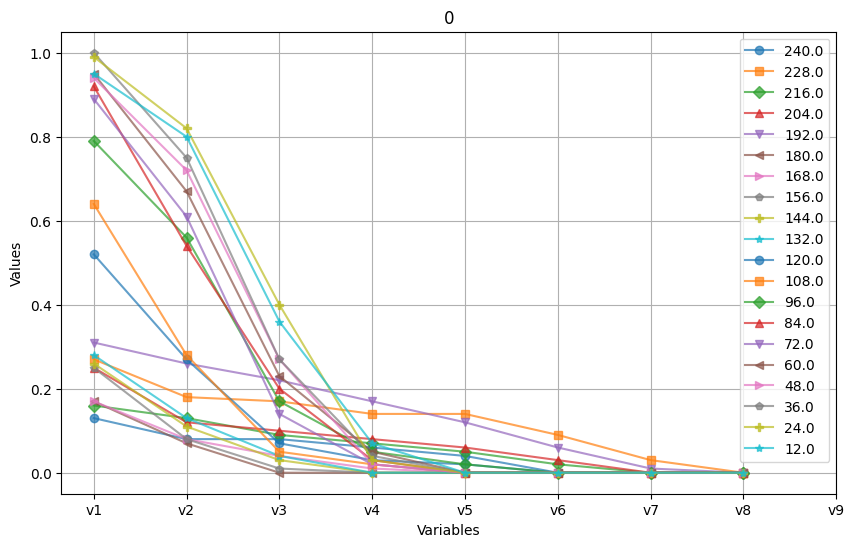

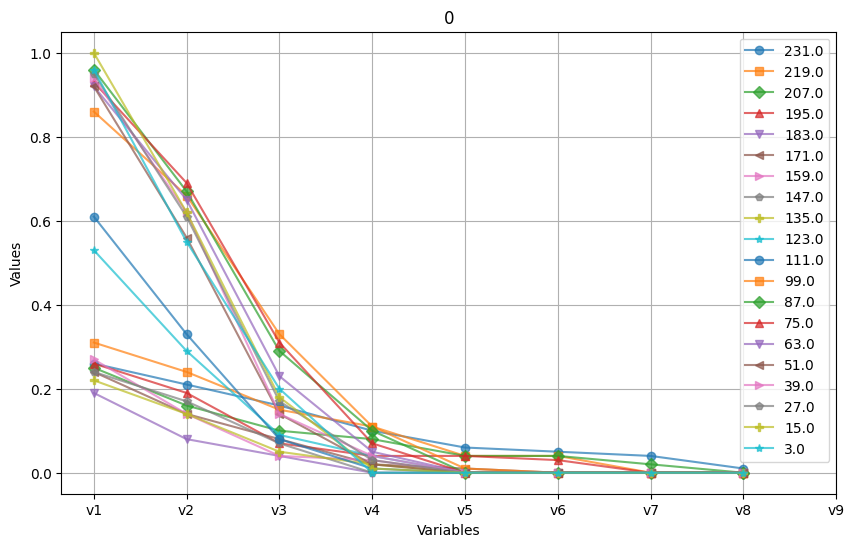

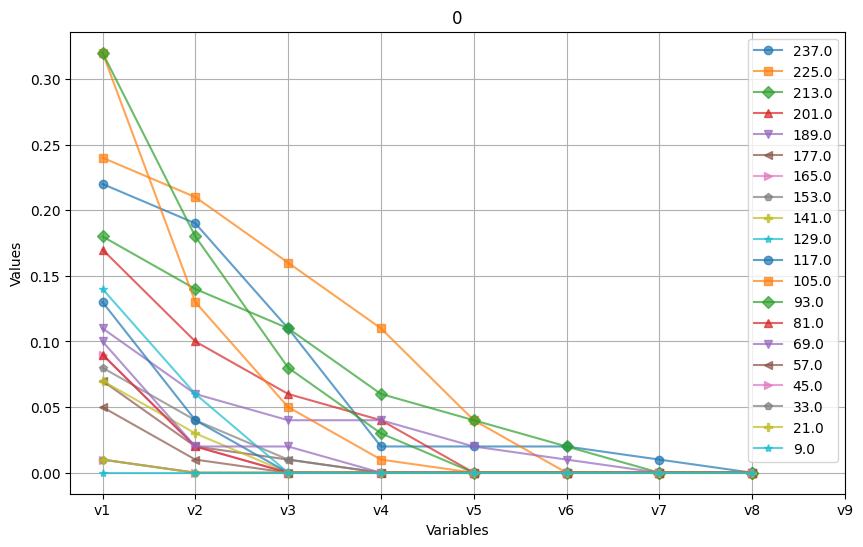

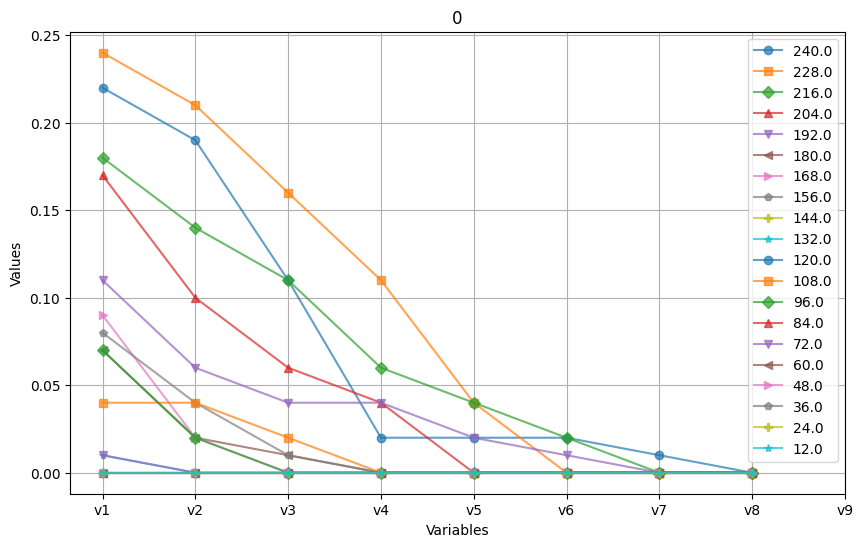

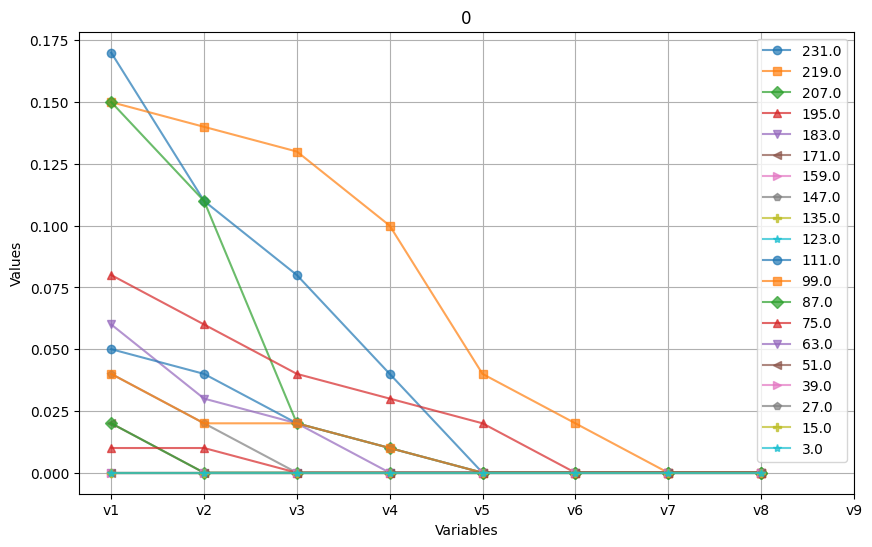

...

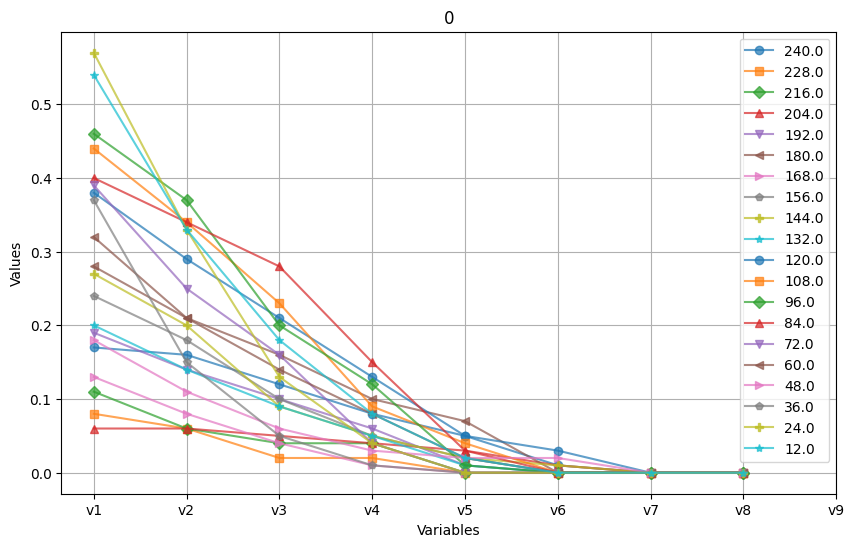

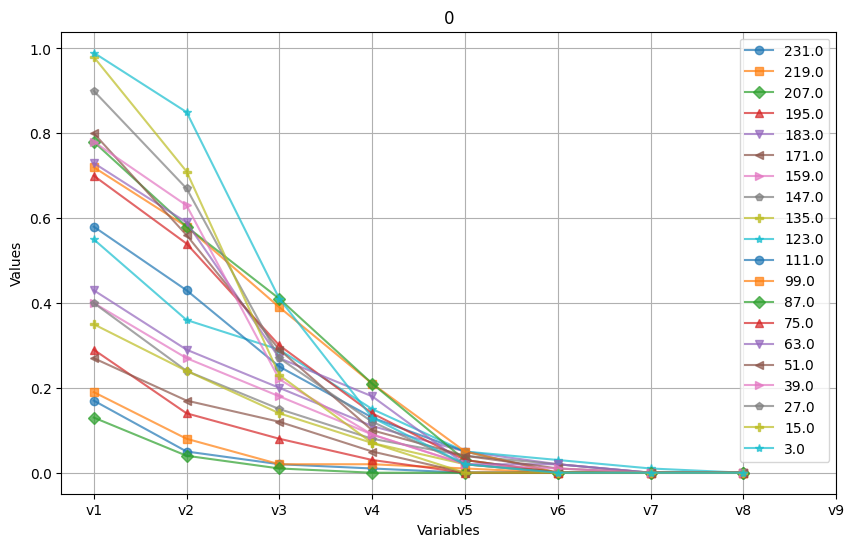

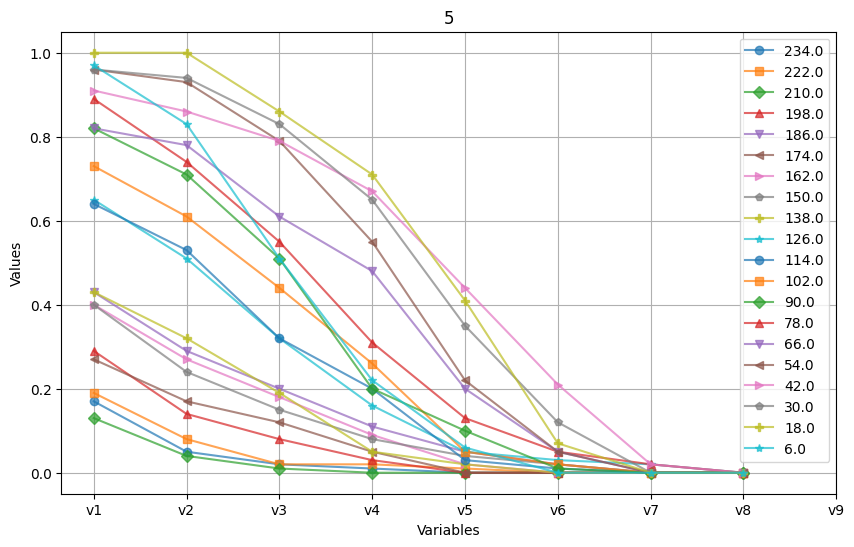

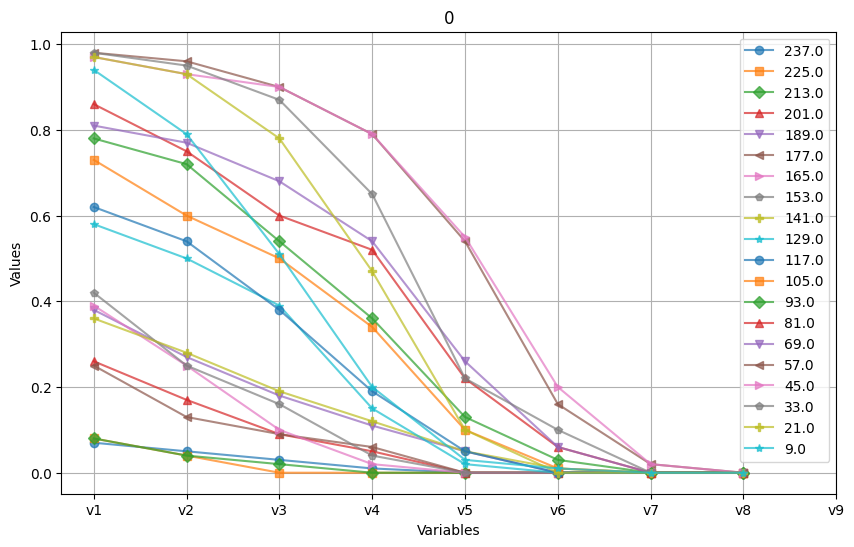

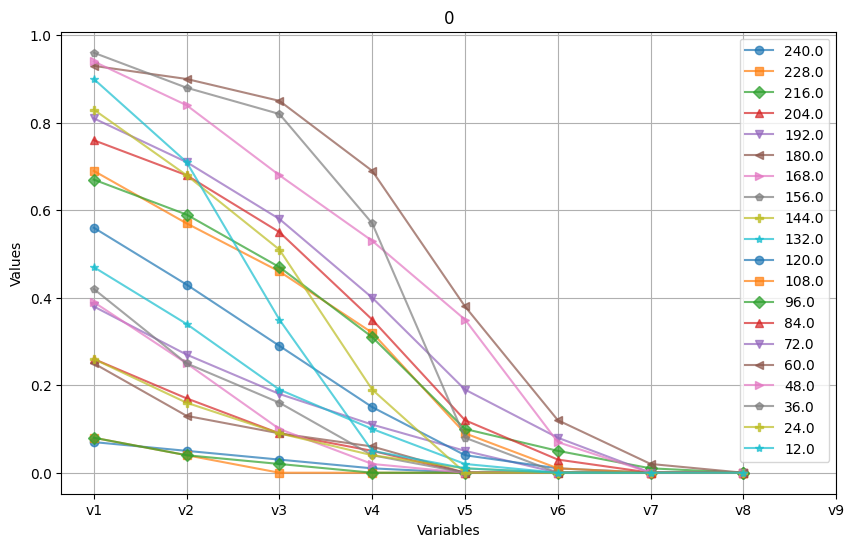

In [4]:
import matplotlib.pyplot as plt
x_labels = [f'v{i+1}' for i in range(9)]  # v1, v2, ..., v9
# List of marker styles to cycle through
markers = ['o', 's', 'D', '^', 'v', '<', '>', 'p', 'P', '*']

# Loop through each set of data in xs
for j in range(1000,1100):
    plt.figure(figsize=(10, 6))
    for i in range(len(xs[j])):
        # Assign a distinct color and marker for each line
        color = plt.cm.tab10(i % 10)  # Use a colormap with 10 distinct colors
        marker = markers[i % len(markers)]
        
        plt.plot(xs[j][i][5:], marker=marker, label=f'{xs[j][i][3]}', color=color, alpha=0.7)
    
    # Set x-axis labels
    plt.xticks(ticks=range(9), labels=x_labels)
    
    # Set plot title and labels
    plt.xlabel('Variables')
    plt.ylabel('Values')
    plt.title(ys[j])
    
    # Show legend
    plt.legend()
    
    # Show grid
    plt.grid(True)
    
    # Display the plot
    plt.show()

Binary Classification

Epoch 1/50
1551/1551 [==============================] - 21s 11ms/step - loss: 0.3168 - accuracy: 0.8701 - val_loss: 0.2334 - val_accuracy: 0.9069
Epoch 2/50
1551/1551 [==============================] - 16s 10ms/step - loss: 0.2333 - accuracy: 0.9046 - val_loss: 0.2236 - val_accuracy: 0.9111
Epoch 3/50
1551/1551 [==============================] - 16s 10ms/step - loss: 0.2233 - accuracy: 0.9071 - val_loss: 0.2104 - val_accuracy: 0.9125
Epoch 4/50
1551/1551 [==============================] - 16s 10ms/step - loss: 0.2199 - accuracy: 0.9088 - val_loss: 0.2058 - val_accuracy: 0.9139
Epoch 5/50
1551/1551 [==============================] - 15s 10ms/step - loss: 0.2162 - accuracy: 0.9116 - val_loss: 0.2031 - val_accuracy: 0.9147
Epoch 6/50
1551/1551 [==============================] - 18s 12ms/step - loss: 0.2151 - accuracy: 0.9123 - val_loss: 0.2119 - val_accuracy: 0.9135
Epoch 7/50
1551/1551 [==============================] - 17s 11ms/step - loss: 0.2116 - accuracy: 0.9125 - val_loss: 0.2006 -

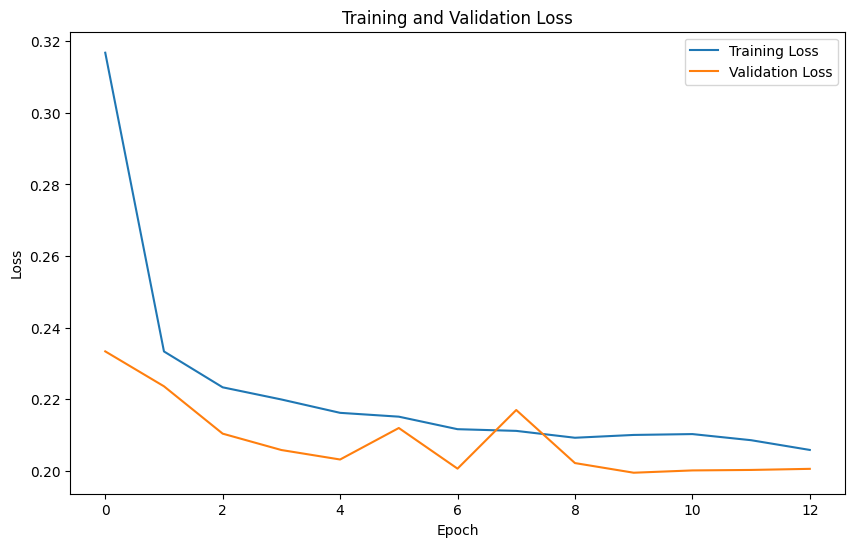

485/485 [==============================] - 3s 4ms/step


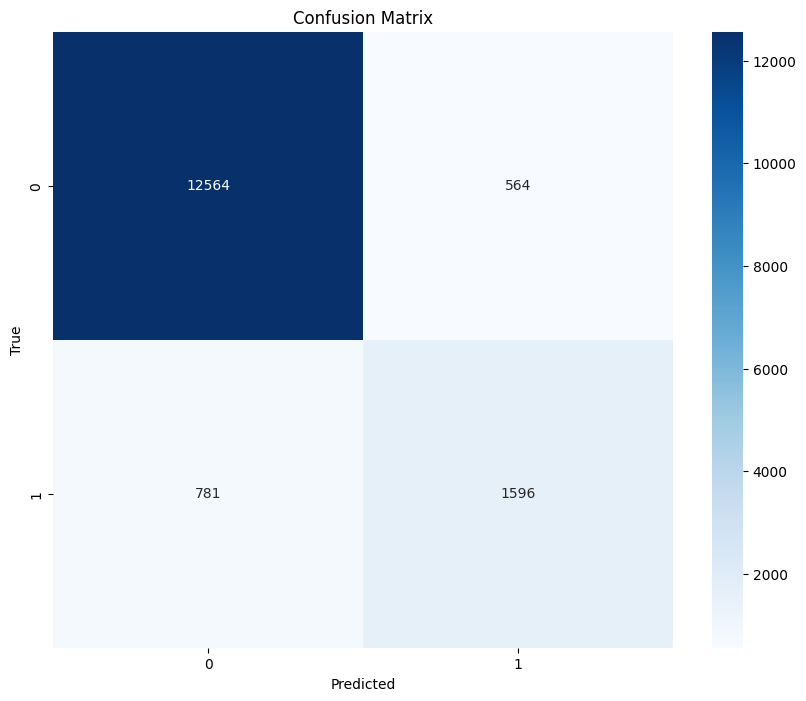

Accuracy: 0.9132537891002902
F1 Score: 0.7035486003967379


In [133]:
xs_flattened = [item.flatten() for item in xs]

# Convert ys to binary labels
ys_binary = np.array([1 if label != 0 else 0 for label in ys])

# Ensure xs_flattened is 2D array and reshaping for RNN input
xs_reshaped = np.array(xs_flattened).reshape(len(xs_flattened), -1, len(xs[0][0]))

# Train-test split before undersampling to avoid data leakage
x_train, x_test, y_train, y_test = train_test_split(xs_reshaped, ys_binary, test_size=0.2, random_state=42)



# Model building
model = Sequential()
model.add(SimpleRNN(50, activation='relu', input_shape=(x_train.shape[1], x_train.shape[2]), return_sequences=True))
model.add(BatchNormalization())
model.add(Dropout(0.2))
model.add(SimpleRNN(50, activation='relu'))
model.add(BatchNormalization())
model.add(Dropout(0.2))
model.add(Dense(128, activation='relu'))
model.add(BatchNormalization())
model.add(Dropout(0.2))
model.add(Dense(64, activation='relu'))
model.add(BatchNormalization())
model.add(Dropout(0.2))
model.add(Dense(1, activation='sigmoid'))  # Output layer for binary classification

# Compile the model
model.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])

# Early stopping callback
early_stopping = EarlyStopping(monitor='val_loss', patience=3, restore_best_weights=True)

# Train the model
history = model.fit(x_train, y_train, epochs=50, batch_size=32, validation_split=0.2, callbacks=[early_stopping])

# Plot training and validation loss
plt.figure(figsize=(10, 6))
plt.plot(history.history['loss'], label='Training Loss')
plt.plot(history.history['val_loss'], label='Validation Loss')
plt.title('Training and Validation Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()
plt.show()

# Evaluate the model on the test set
y_pred_prob = model.predict(x_test)
y_pred_classes = (y_pred_prob > 0.5).astype(int).flatten()
y_test_classes = y_test

# Calculate confusion matrix
cm = confusion_matrix(y_test_classes, y_pred_classes)
plt.figure(figsize=(10, 8))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues')
plt.title('Confusion Matrix')
plt.xlabel('Predicted')
plt.ylabel('True')
plt.show()

# Calculate accuracy and F1 score
accuracy = accuracy_score(y_test_classes, y_pred_classes)
f1 = f1_score(y_test_classes, y_pred_classes)

print(f'Accuracy: {accuracy}')
print(f'F1 Score: {f1}')

In [105]:
sum(ys_binary==1)

11986

Multiclassificaiton without class0

Epoch 1/50
240/240 [==============================] - 6s 10ms/step - loss: 2.4436 - accuracy: 0.1520 - val_loss: 1.9930 - val_accuracy: 0.2263
Epoch 2/50
240/240 [==============================] - 2s 8ms/step - loss: 2.1326 - accuracy: 0.1831 - val_loss: 1.9742 - val_accuracy: 0.2289
Epoch 3/50
240/240 [==============================] - 2s 8ms/step - loss: 2.0314 - accuracy: 0.1939 - val_loss: 1.9270 - val_accuracy: 0.2263
Epoch 4/50
240/240 [==============================] - 2s 8ms/step - loss: 1.9887 - accuracy: 0.2052 - val_loss: 1.8983 - val_accuracy: 0.2414
Epoch 5/50
240/240 [==============================] - 2s 8ms/step - loss: 1.9622 - accuracy: 0.2203 - val_loss: 1.8812 - val_accuracy: 0.2503
Epoch 6/50
240/240 [==============================] - 3s 11ms/step - loss: 1.9390 - accuracy: 0.2236 - val_loss: 1.8673 - val_accuracy: 0.2440
Epoch 7/50
240/240 [==============================] - 2s 9ms/step - loss: 1.9194 - accuracy: 0.2325 - val_loss: 1.8528 - val_accuracy: 0.2570
Epoc

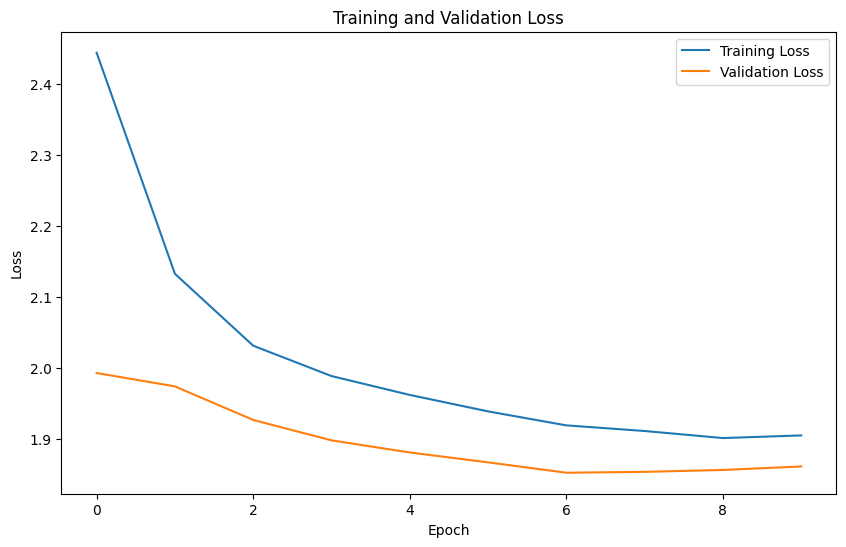

75/75 [==============================] - 1s 3ms/step


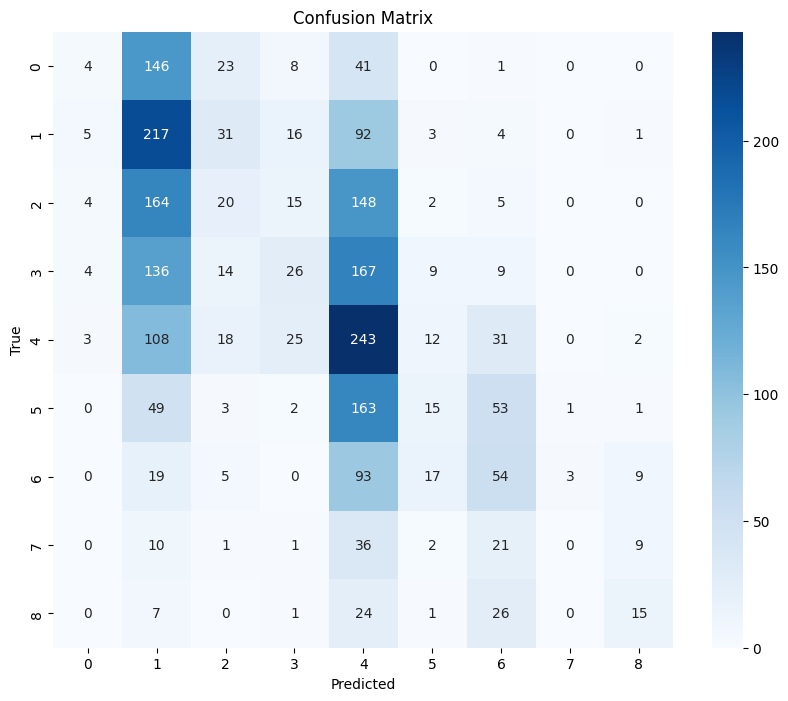

Accuracy: 0.24770642201834864
F1 Score: 0.19022258939627576


In [108]:
filtered_indices = [i for i, y in enumerate(ys) if y != 0]
xs_rain = [xs[i] for i in filtered_indices]
ys_rain = [ys[i] for i in filtered_indices]

# Flatten xs for model training
xs_flattened = [item.flatten() for item in xs_rain]
ys_encoded = LabelEncoder().fit_transform(ys_rain)

# Ensure xs_flattened is 2D array and reshaping for RNN input
xs_reshaped = np.array(xs_flattened).reshape(len(xs_flattened), -1, len(xs_rain[0][0]))

# Convert ys to categorical for multi-class classification
ys_categorical = to_categorical(ys_encoded)

# Train-test split
x_train, x_test, y_train, y_test = train_test_split(xs_reshaped, ys_categorical, test_size=0.2, random_state=42)

# Model building
model = Sequential()
model.add(SimpleRNN(50, activation='relu', input_shape=(x_train.shape[1], x_train.shape[2]), return_sequences=True))
model.add(BatchNormalization())
model.add(Dropout(0.2))
model.add(SimpleRNN(50, activation='relu'))
model.add(BatchNormalization())
model.add(Dropout(0.2))
model.add(Dense(128, activation='relu'))
model.add(BatchNormalization())
model.add(Dropout(0.2))
model.add(Dense(64, activation='relu'))
model.add(BatchNormalization())
model.add(Dropout(0.2))
model.add(Dense(y_train.shape[1], activation='softmax'))  # Output layer for multi-class classification

# Compile the model
model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])

# Early stopping callback
early_stopping = EarlyStopping(monitor='val_loss', patience=3, restore_best_weights=True)

# Train the model
history = model.fit(x_train, y_train, epochs=50, batch_size=32, validation_split=0.2, callbacks=[early_stopping])

# Plot training and validation loss
plt.figure(figsize=(10, 6))
plt.plot(history.history['loss'], label='Training Loss')
plt.plot(history.history['val_loss'], label='Validation Loss')
plt.title('Training and Validation Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()
plt.show()

# Evaluate the model on the test set
y_pred = model.predict(x_test)
y_pred_classes = np.argmax(y_pred, axis=1)
y_test_classes = np.argmax(y_test, axis=1)

# Calculate confusion matrix
cm = confusion_matrix(y_test_classes, y_pred_classes)
plt.figure(figsize=(10, 8))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues')
plt.title('Confusion Matrix')
plt.xlabel('Predicted')
plt.ylabel('True')
plt.show()

# Calculate accuracy and F1 score
accuracy = accuracy_score(y_test_classes, y_pred_classes)
f1 = f1_score(y_test_classes, y_pred_classes, average='weighted')

print(f'Accuracy: {accuracy}')
print(f'F1 Score: {f1}')

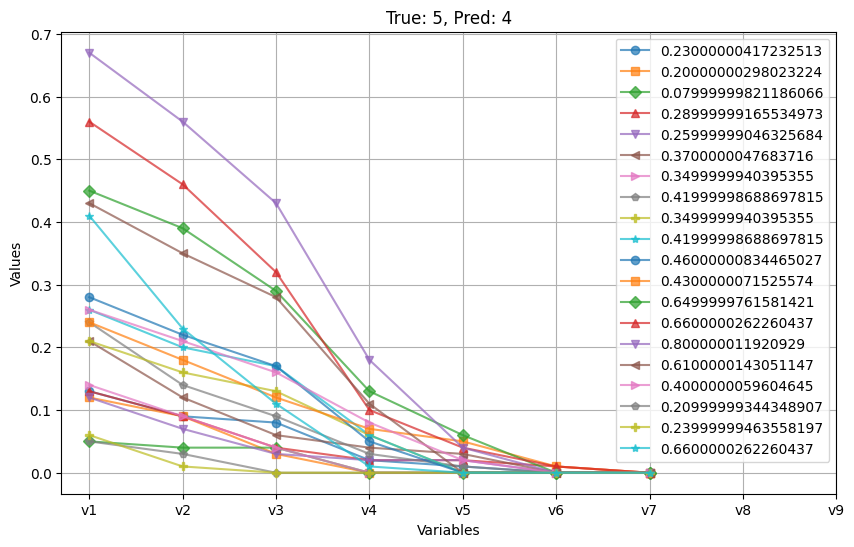

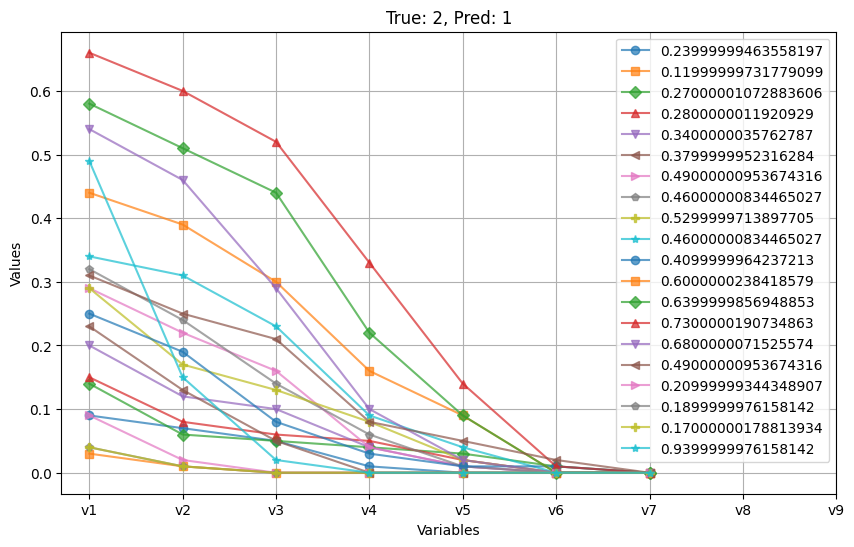

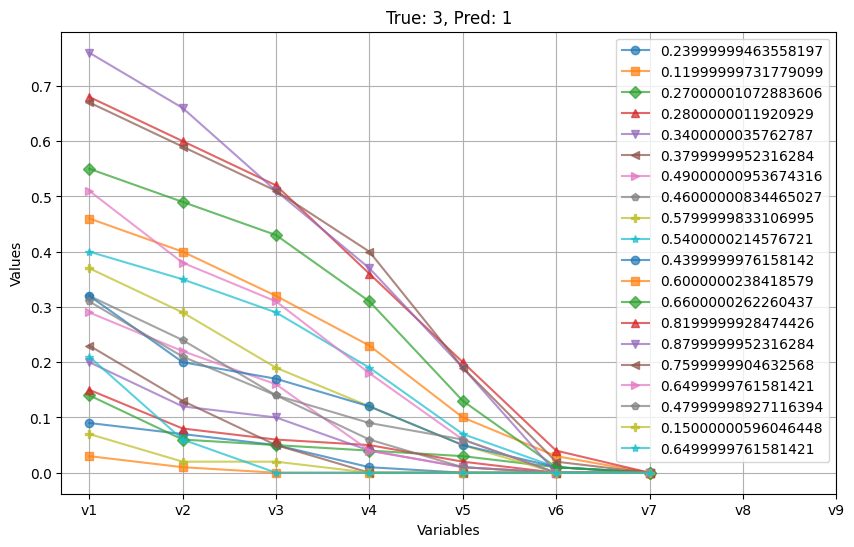

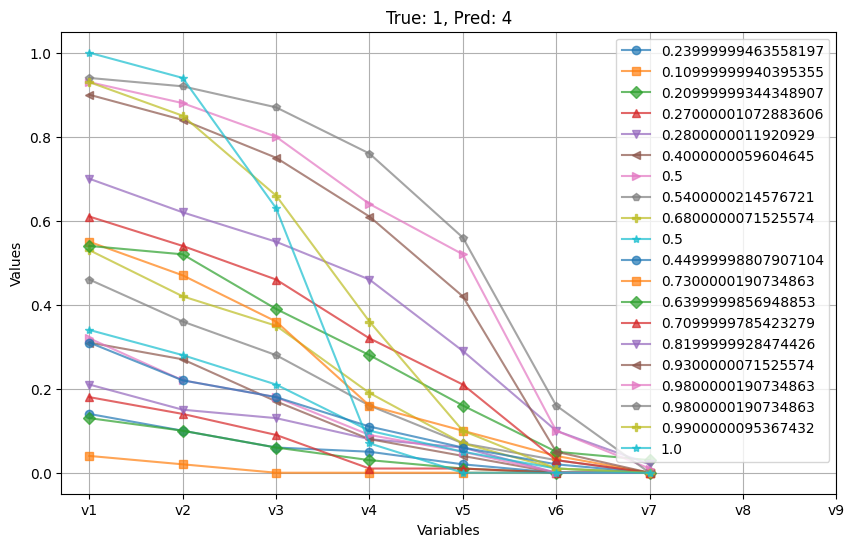

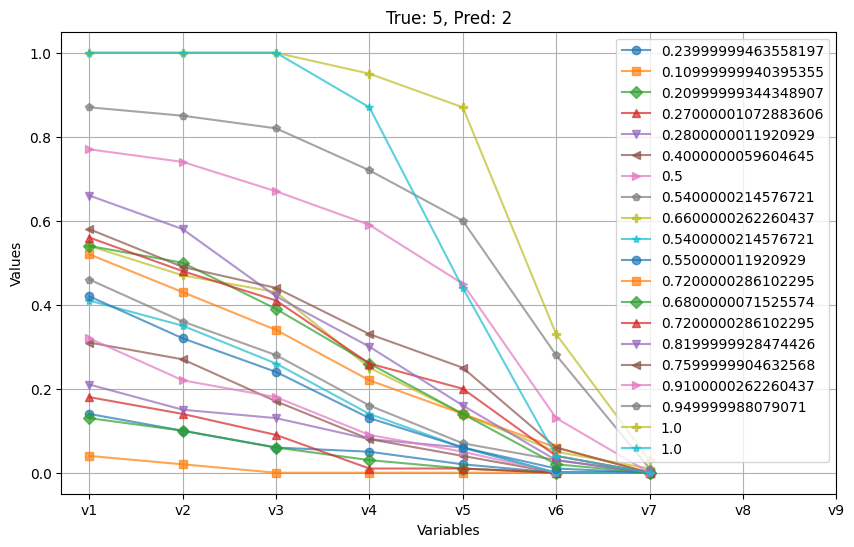

...

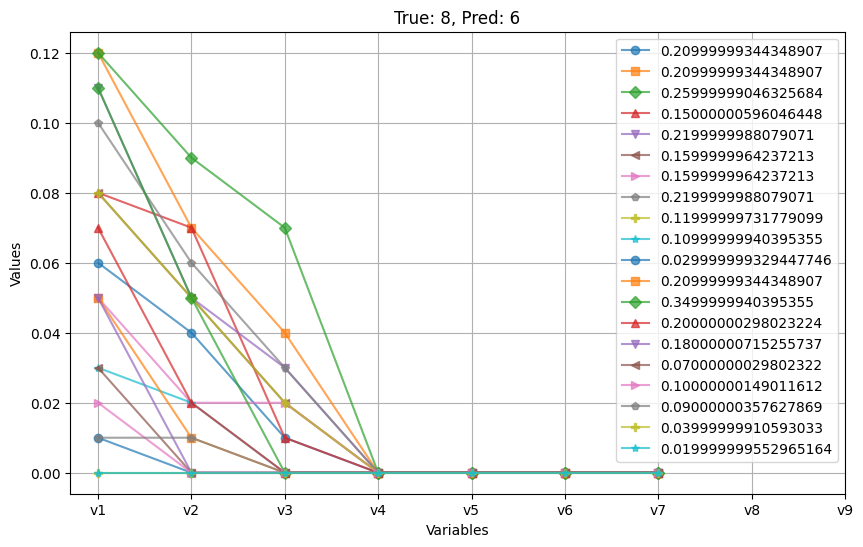

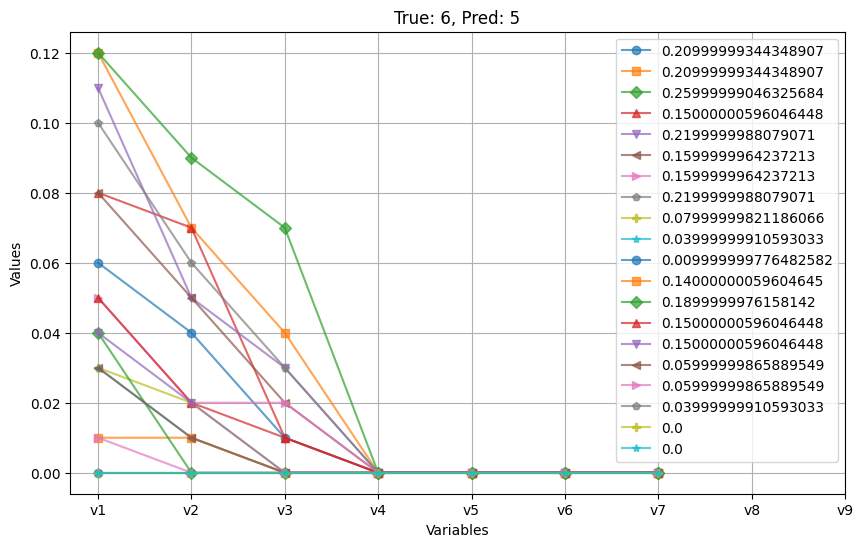

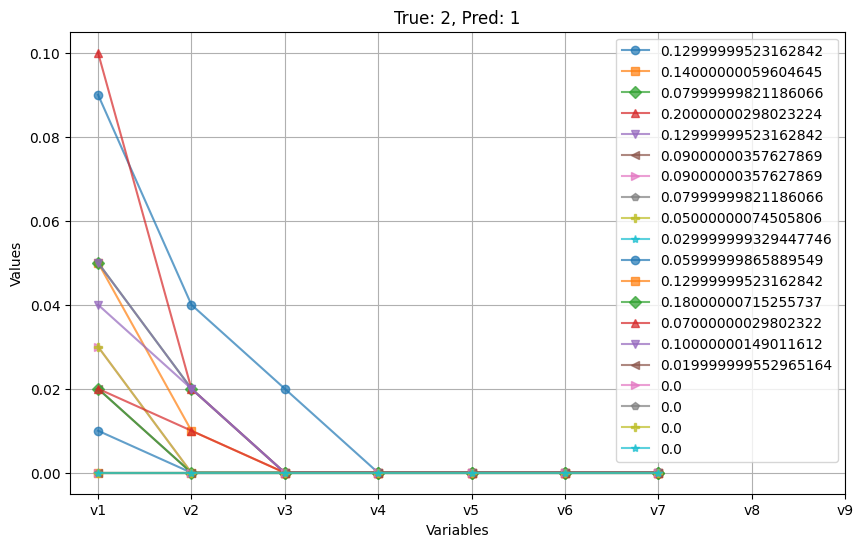

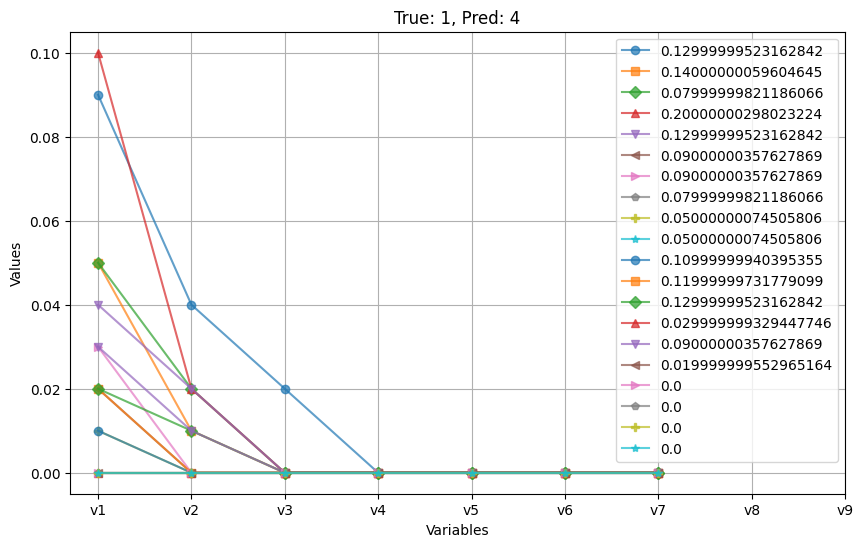

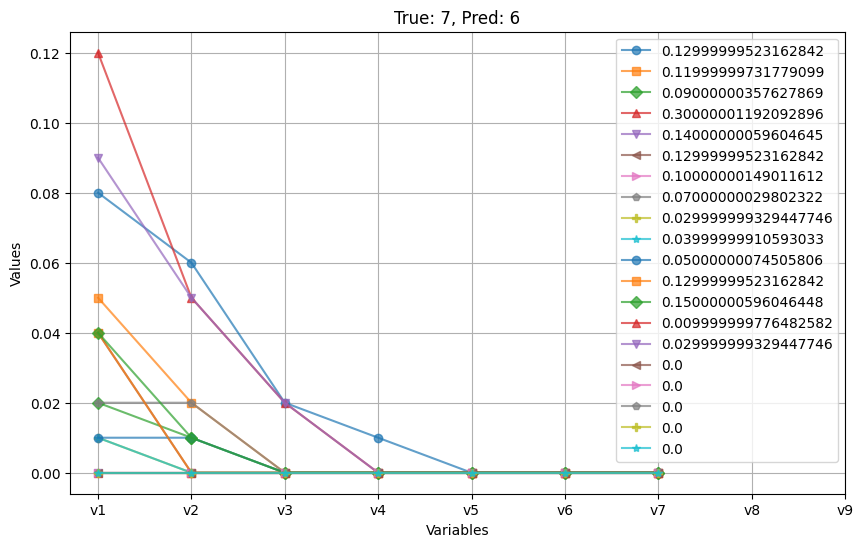

In [136]:
import numpy as np
import matplotlib.pyplot as plt

# Assuming xs, y_pred_classes, and y_test_classes are already defined

# Identify misclassified instances
misclassified_indices = np.where(y_pred_classes != y_test_classes)[0]

# Labels for x-axis
x_labels = [f'v{i+1}' for i in range(9)]  # v1, v2, ..., v9

# List of marker styles to cycle through
markers = ['o', 's', 'D', '^', 'v', '<', '>', 'p', 'P', '*']

# Loop through each misclassified instance
for j in misclassified_indices[100:120]:
    plt.figure(figsize=(10, 6))
    for i in range(len(xs[j])):
        # Assign a distinct color and marker for each line
        color = plt.cm.tab10(i % 10)  # Use a colormap with 10 distinct colors
        marker = markers[i % len(markers)]
        
        # Plot the data
        plt.plot(xs[j][i][5:], marker=marker, label=f'{xs[j][i][3]}', color=color, alpha=0.7)
    
    # Set x-axis labels
    plt.xticks(ticks=range(9), labels=x_labels)
    
    # Set plot title and labels
    plt.xlabel('Variables')
    plt.ylabel('Values')
    plt.title(f'True: {y_test_classes[j]}, Pred: {y_pred_classes[j]}')
    
    # Show legend
    plt.legend()
    
    # Show grid
    plt.grid(True)
    
    # Display the plot
    plt.show()


Epoch 1/50
240/240 [==============================] - 17s 48ms/step - loss: 2.5324 - accuracy: 0.1480 - val_loss: 2.1559 - val_accuracy: 0.1767
Epoch 2/50
240/240 [==============================] - 12s 52ms/step - loss: 2.1490 - accuracy: 0.1909 - val_loss: 2.6344 - val_accuracy: 0.1924
Epoch 3/50
240/240 [==============================] - 12s 50ms/step - loss: 2.0547 - accuracy: 0.2033 - val_loss: 2.0000 - val_accuracy: 0.1908
Epoch 4/50
240/240 [==============================] - 12s 49ms/step - loss: 1.9780 - accuracy: 0.2203 - val_loss: 1.9110 - val_accuracy: 0.2346
Epoch 5/50
240/240 [==============================] - 14s 57ms/step - loss: 1.9481 - accuracy: 0.2280 - val_loss: 1.9325 - val_accuracy: 0.2117
Epoch 6/50
240/240 [==============================] - 12s 52ms/step - loss: 1.9317 - accuracy: 0.2318 - val_loss: 1.9673 - val_accuracy: 0.2075
Epoch 7/50
240/240 [==============================] - 11s 47ms/step - loss: 1.9194 - accuracy: 0.2400 - val_loss: 1.9722 - val_accuracy:

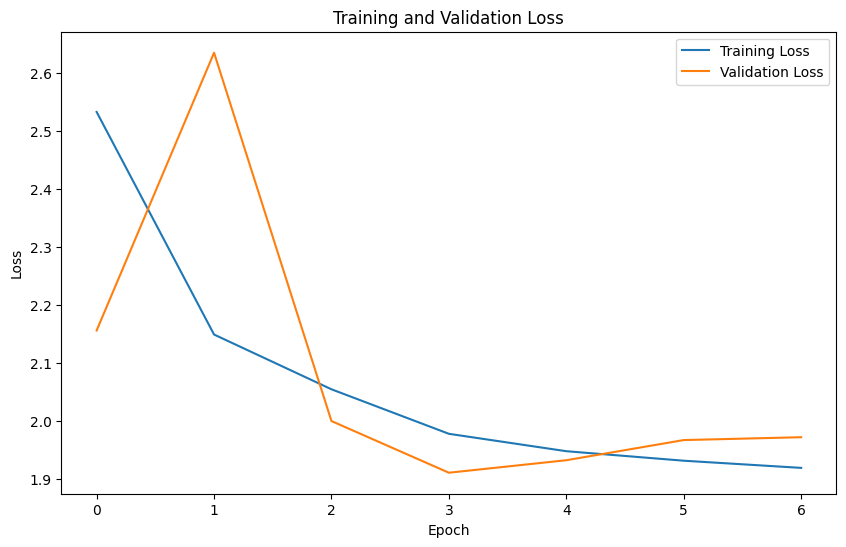

75/75 [==============================] - 1s 13ms/step


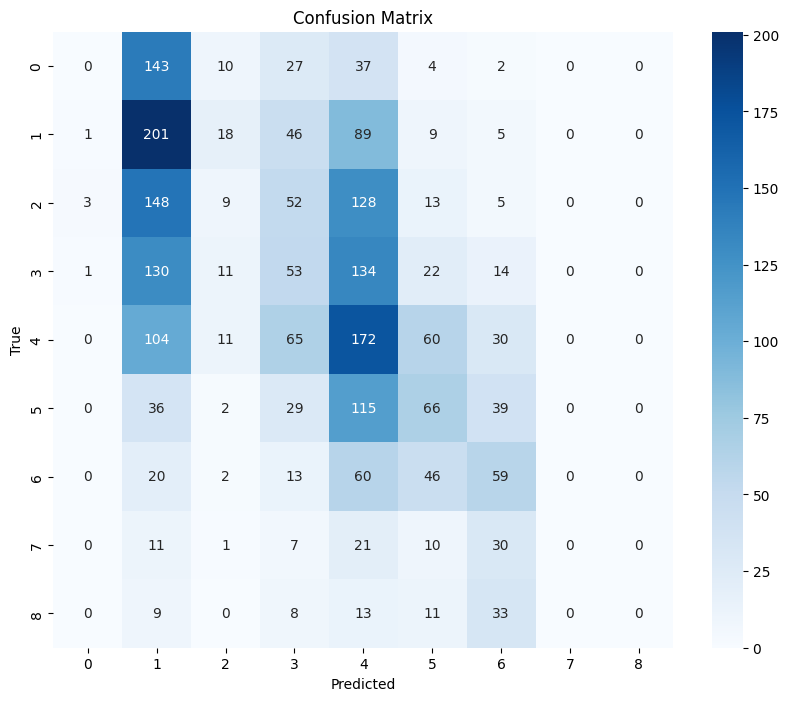

Accuracy: 0.2335279399499583
F1 Score: 0.18933586388300122


In [134]:
import numpy as np
from sklearn.preprocessing import LabelEncoder
from sklearn.model_selection import train_test_split
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Input, LSTM, Dense, BatchNormalization, Dropout, Conv1D, MaxPooling1D, Flatten, Attention, concatenate
from tensorflow.keras.utils import to_categorical
from tensorflow.keras.callbacks import EarlyStopping
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics import confusion_matrix, accuracy_score, f1_score

# Example data for demonstration (replace with your actual data)
# Assuming xs and ys are prepared as shown in the previous steps

# Filter out samples with class 0
filtered_indices = [i for i, y in enumerate(ys) if y != 0]
xs_filtered = [xs[i] for i in filtered_indices]
ys_filtered = [ys[i] for i in filtered_indices]

# Flatten xs for model training
xs_flattened = [item.flatten() for item in xs_filtered]
ys_encoded = LabelEncoder().fit_transform(ys_filtered)

# Ensure xs_flattened is 2D array and reshaping for LSTM input
xs_reshaped = np.array(xs_flattened).reshape(len(xs_flattened), -1, len(xs_filtered[0][0]))

# Convert ys to categorical for multi-class classification
ys_categorical = to_categorical(ys_encoded)

# Train-test split
x_train, x_test, y_train, y_test = train_test_split(xs_reshaped, ys_categorical, test_size=0.2, random_state=42)

# Model building
input_layer = Input(shape=(x_train.shape[1], x_train.shape[2]))

# CNN layers
cnn_layer = Conv1D(filters=64, kernel_size=3, activation='relu', padding='same')(input_layer)
cnn_layer = MaxPooling1D(pool_size=2)(cnn_layer)
cnn_layer = Conv1D(filters=128, kernel_size=3, activation='relu', padding='same')(cnn_layer)
cnn_layer = MaxPooling1D(pool_size=2)(cnn_layer)
cnn_layer = Flatten()(cnn_layer)

# LSTM layers
lstm_layer = LSTM(100, activation='relu', return_sequences=True)(input_layer)
lstm_layer = LSTM(100, activation='relu')(lstm_layer)

# Attention mechanism
attention = Attention()([lstm_layer, lstm_layer])

# Combine CNN and LSTM with attention
combined_layer = concatenate([cnn_layer, lstm_layer, attention])

# Dense layers
dense_layer = Dense(256, activation='relu')(combined_layer)
dense_layer = BatchNormalization()(dense_layer)
dense_layer = Dropout(0.3)(dense_layer)
dense_layer = Dense(128, activation='relu')(dense_layer)
dense_layer = BatchNormalization()(dense_layer)
dense_layer = Dropout(0.3)(dense_layer)
output_layer = Dense(y_train.shape[1], activation='softmax')(dense_layer)

# Model definition
model = Model(inputs=input_layer, outputs=output_layer)

# Compile the model
model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])

# Early stopping callback
early_stopping = EarlyStopping(monitor='val_loss', patience=3, restore_best_weights=True)

# Train the model
history = model.fit(x_train, y_train, epochs=50, batch_size=32, validation_split=0.2, callbacks=[early_stopping])

# Plot training and validation loss
plt.figure(figsize=(10, 6))
plt.plot(history.history['loss'], label='Training Loss')
plt.plot(history.history['val_loss'], label='Validation Loss')
plt.title('Training and Validation Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()
plt.show()

# Evaluate the model on the test set
y_pred = model.predict(x_test)
y_pred_classes = np.argmax(y_pred, axis=1)
y_test_classes = np.argmax(y_test, axis=1)

# Calculate confusion matrix
cm = confusion_matrix(y_test_classes, y_pred_classes)
plt.figure(figsize=(10, 8))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues')
plt.title('Confusion Matrix')
plt.xlabel('Predicted')
plt.ylabel('True')
plt.show()

# Calculate accuracy and F1 score
accuracy = accuracy_score(y_test_classes, y_pred_classes)
f1 = f1_score(y_test_classes, y_pred_classes, average='weighted')

print(f'Accuracy: {accuracy}')
print(f'F1 Score: {f1}')

In [135]:
xs

array([[[0.0000000e+00, 0.0000000e+00, 0.0000000e+00, ...,
         0.0000000e+00, 0.0000000e+00, 0.0000000e+00],
        [0.0000000e+00, 0.0000000e+00, 0.0000000e+00, ...,
         0.0000000e+00, 0.0000000e+00, 0.0000000e+00],
        [0.0000000e+00, 0.0000000e+00, 0.0000000e+00, ...,
         0.0000000e+00, 0.0000000e+00, 0.0000000e+00],
        ...,
        [0.0000000e+00, 0.0000000e+00, 0.0000000e+00, ...,
         0.0000000e+00, 0.0000000e+00, 0.0000000e+00],
        [0.0000000e+00, 0.0000000e+00, 0.0000000e+00, ...,
         0.0000000e+00, 0.0000000e+00, 0.0000000e+00],
        [0.0000000e+00, 0.0000000e+00, 0.0000000e+00, ...,
         0.0000000e+00, 0.0000000e+00, 0.0000000e+00]],

       [[0.0000000e+00, 0.0000000e+00, 1.2658228e-02, ...,
         0.0000000e+00, 0.0000000e+00, 0.0000000e+00],
        [0.0000000e+00, 0.0000000e+00, 0.0000000e+00, ...,
         0.0000000e+00, 0.0000000e+00, 0.0000000e+00],
        [0.0000000e+00, 0.0000000e+00, 0.0000000e+00, ...,
         0.000